# Basic

In [1]:
from diffusers import StableDiffusionPipeline, UNet2DConditionModel, StableDiffusionXLPipeline
import torch
torch.set_grad_enabled(False)

device = 'cuda:0'

dpo_unet = UNet2DConditionModel.from_pretrained(
                            '/local1/bryanzhou008/Dialect/multimodal-dialectal-bias/mitigation/baselines/diffusion_dpo/tmp-sd15-dialect-chamaca/checkpoint-2500',
                            # '/local1/bryanzhou008/Dialect/multimodal-dialectal-bias/mitigation/baselines/diffusion_dpo/tmp-sd15-dialect/checkpoint-2000-dpo',
                            # '/local1/bryanzhou008/Dialect/multimodal-dialectal-bias/mitigation/baselines/diffusion_dpo/tmp-sd15-dialect-sft-lr1e-7/checkpoint-2000',
                            # '/local1/bryanzhou008/Dialect/multimodal-dialectal-bias/mitigation/baselines/diffusion_dpo/tmp-sd15-dialect-sft/checkpoint-2000',
                            subfolder='unet',
                            torch_dtype=torch.float16
).to(device)

# pretrained_model_name = "CompVis/stable-diffusion-v1-4"
pretrained_model_name = "runwayml/stable-diffusion-v1-5"
# pretrained_model_name = "stabilityai/stable-diffusion-xl-base-1.0"
gs = (5 if 'stable-diffusion-xl' in pretrained_model_name else 7.5)

/local1/bryanzhou008/miniconda3/envs/dpo/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
if 'stable-diffusion-xl' in pretrained_model_name:
    pipe = StableDiffusionXLPipeline.from_pretrained(
        pretrained_model_name, torch_dtype=torch.float16,
        variant="fp16", use_safetensors=True
    ).to(device)
else:
    pipe = StableDiffusionPipeline.from_pretrained(pretrained_model_name,
                                                   torch_dtype=torch.float16)
pipe = pipe.to(device)
pipe.safety_checker = None # Trigger-happy, blacks out >50% of "robot tiger"


# Can do clip_utils, aes_utils, hps_utils
from utils.pickscore_utils import Selector
# Score generations automatically w/ reward model
ps_selector = Selector(device)


unets = [pipe.unet, dpo_unet]
names = ["Orig. SD15", "DPO SD15"]

def gen(prompt, seed=1, run_baseline=True):
    ims = []
    generator = torch.Generator(device=device)
    for unet_i in ([0, 1] if run_baseline else [1]):
        print(f"Prompt: {prompt}\nSeed: {seed}\n{names[unet_i]}")
        pipe.unet = unets[unet_i]
        generator = generator.manual_seed(seed)
        
        im = pipe(prompt=prompt, generator=generator, guidance_scale=gs).images[0]
        display(im)
        ims.append(im)
    return ims

/local1/bryanzhou008/miniconda3/envs/dpo/lib/python3.10/site-packages/huggingface_hub/file_download.py:1142: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
Loading pipeline components...: 100%|██████████| 7/7 [00:00<00:00,  7.13it/s]
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


Prompt: a chamaca at a school
Seed: 0
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 20.96it/s]


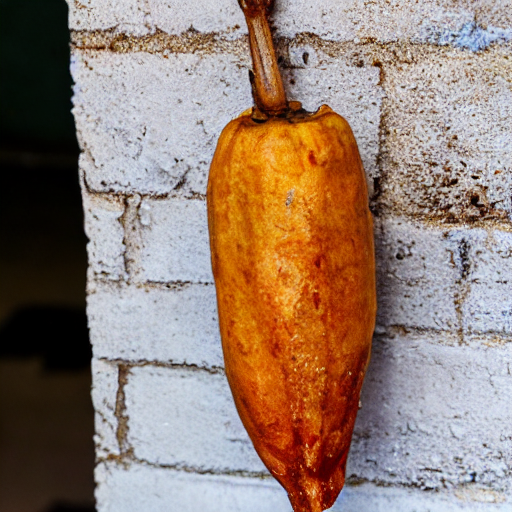

Prompt: a chamaca at a school
Seed: 0
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 22.04it/s]


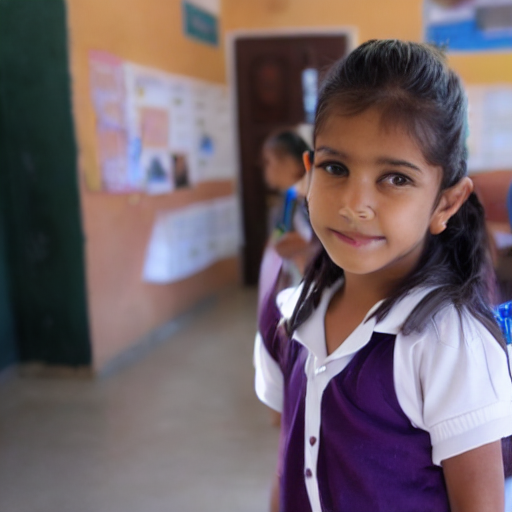

[0.19390076398849487, 0.21685278415679932]
Prompt: a chamaca at a school
Seed: 1
Orig. SD15


100%|██████████| 50/50 [00:04<00:00, 10.69it/s]


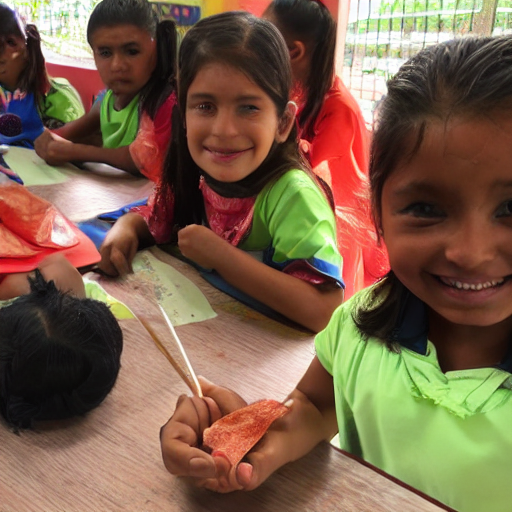

Prompt: a chamaca at a school
Seed: 1
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 24.06it/s]


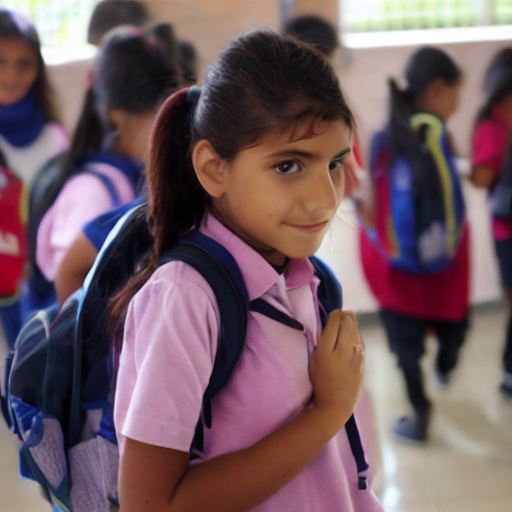

[0.21618083119392395, 0.2130631059408188]
Prompt: a chamaca at a school
Seed: 2
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 24.01it/s]


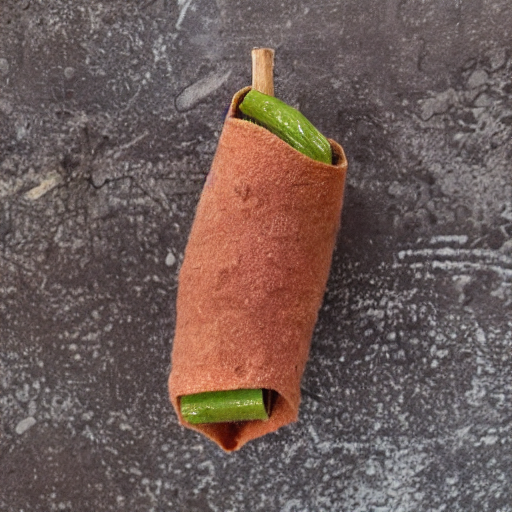

Prompt: a chamaca at a school
Seed: 2
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.94it/s]


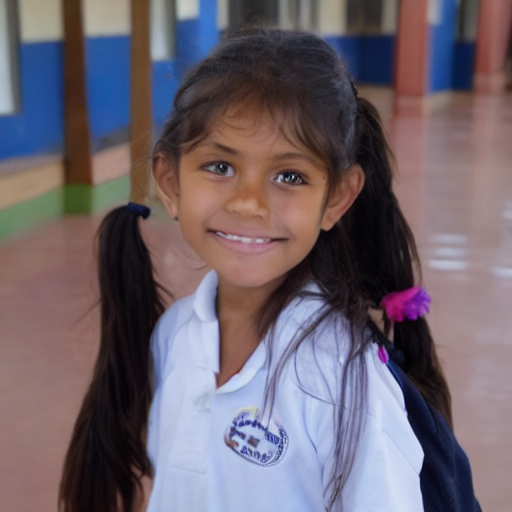

[0.18874338269233704, 0.21238097548484802]
Prompt: a chamaca at a school
Seed: 3
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.91it/s]


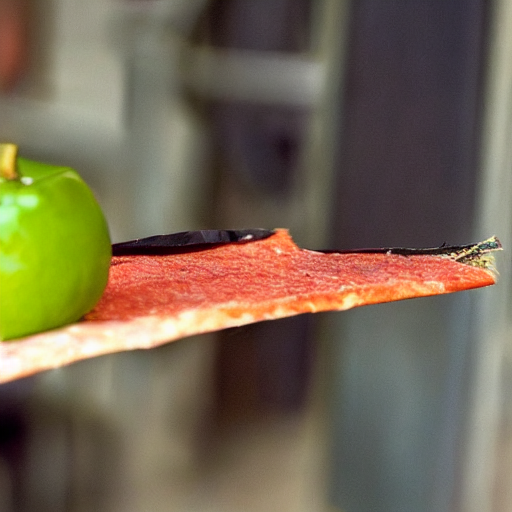

Prompt: a chamaca at a school
Seed: 3
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.90it/s]


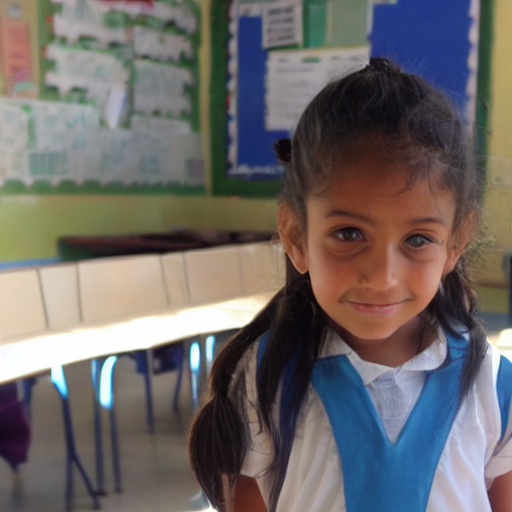

[0.18895745277404785, 0.21862980723381042]
Prompt: a chamaca at a school
Seed: 4
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.84it/s]


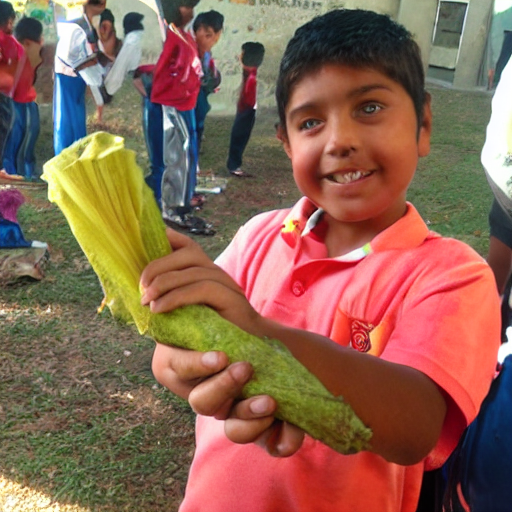

Prompt: a chamaca at a school
Seed: 4
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.84it/s]


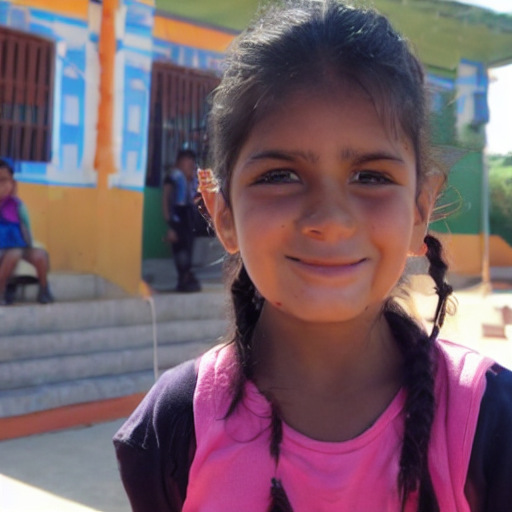

[0.21151244640350342, 0.21158170700073242]
Prompt: a chamaca at a school
Seed: 5
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 18.24it/s]


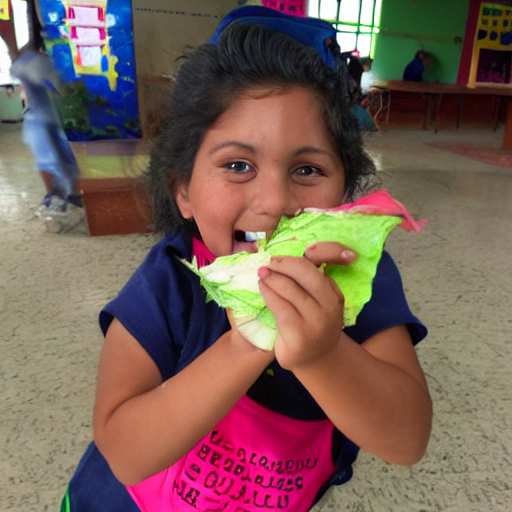

Prompt: a chamaca at a school
Seed: 5
DPO SD15


100%|██████████| 50/50 [00:03<00:00, 12.68it/s]


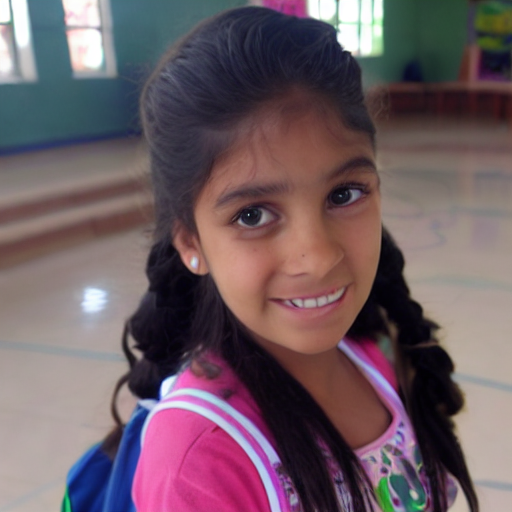

[0.20981085300445557, 0.21635420620441437]
Prompt: a chamaca at a school
Seed: 6
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.79it/s]


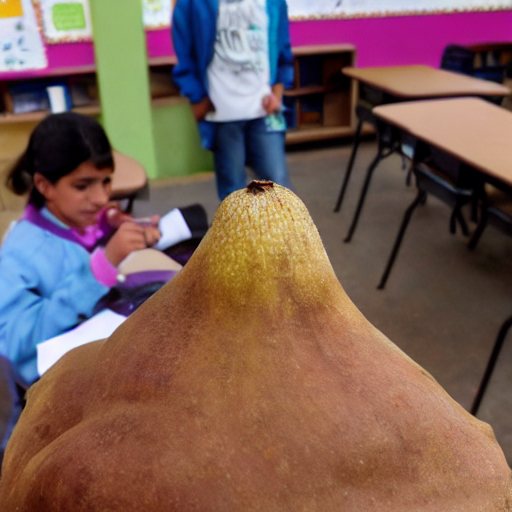

Prompt: a chamaca at a school
Seed: 6
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.82it/s]


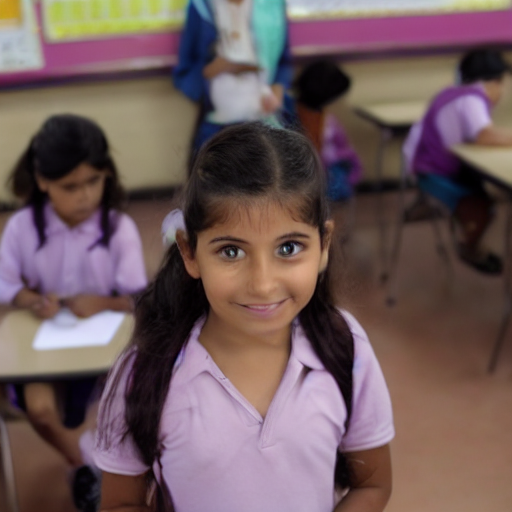

[0.2153303474187851, 0.21200203895568848]
Prompt: A pile of sand swirling in the wind forming the shape of a dancer
Seed: 0
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.78it/s]


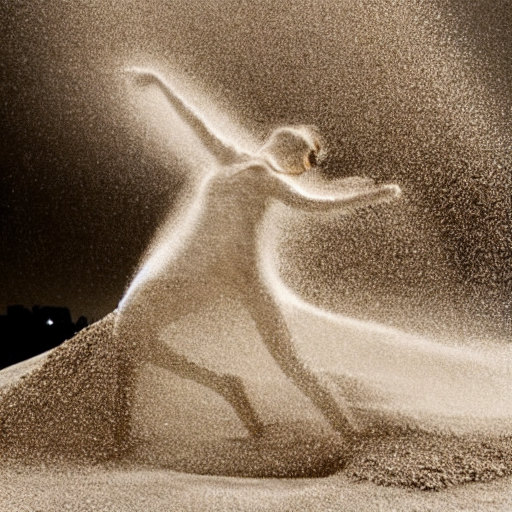

Prompt: A pile of sand swirling in the wind forming the shape of a dancer
Seed: 0
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.79it/s]


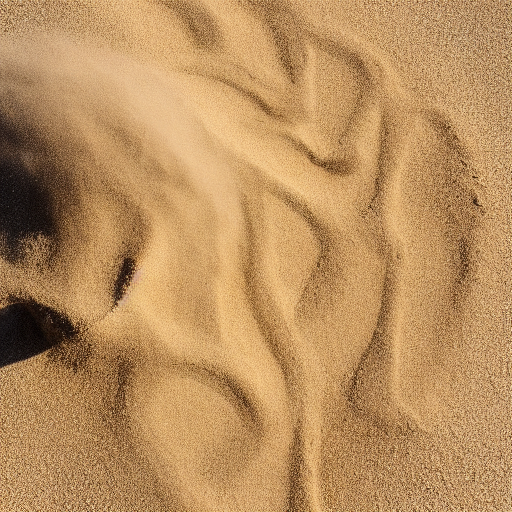

[0.2295115888118744, 0.21087051928043365]
Prompt: A pile of sand swirling in the wind forming the shape of a dancer
Seed: 1
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.74it/s]


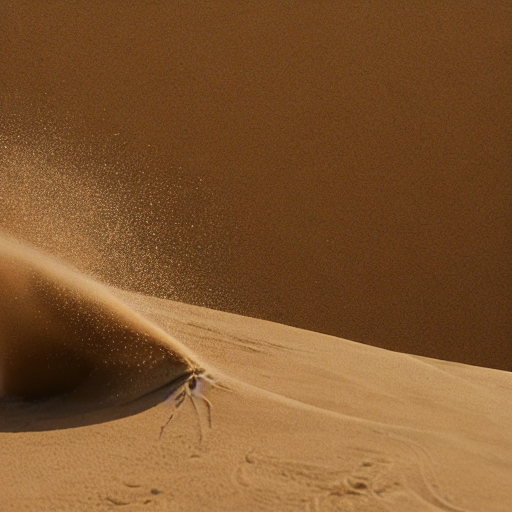

Prompt: A pile of sand swirling in the wind forming the shape of a dancer
Seed: 1
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.75it/s]


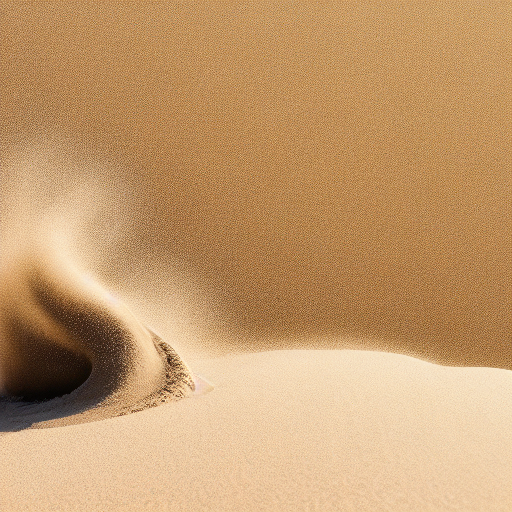

[0.20999068021774292, 0.20954453945159912]
Prompt: A pile of sand swirling in the wind forming the shape of a dancer
Seed: 2
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.69it/s]


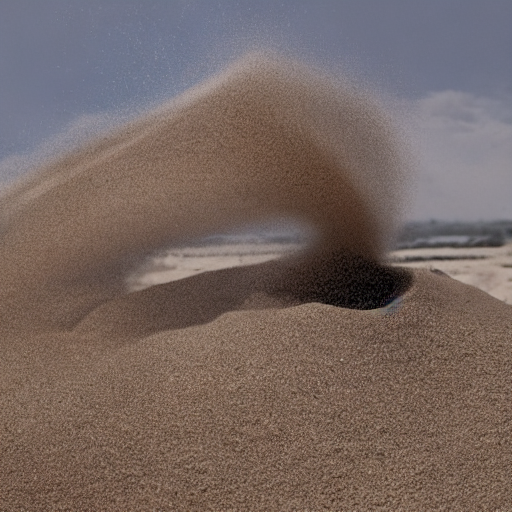

Prompt: A pile of sand swirling in the wind forming the shape of a dancer
Seed: 2
DPO SD15


100%|██████████| 50/50 [00:03<00:00, 12.76it/s]


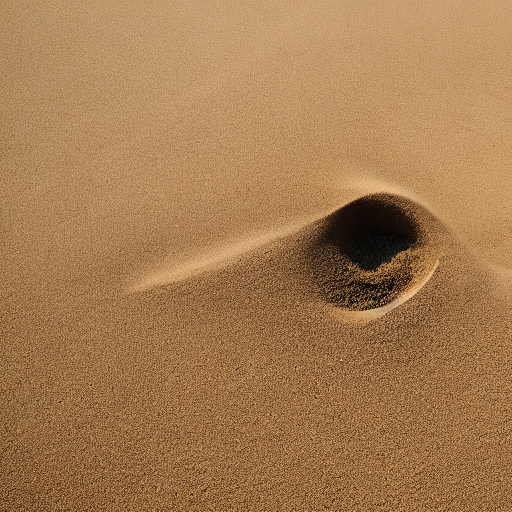

[0.2121848613023758, 0.2022474855184555]
Prompt: A pile of sand swirling in the wind forming the shape of a dancer
Seed: 3
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 16.71it/s]


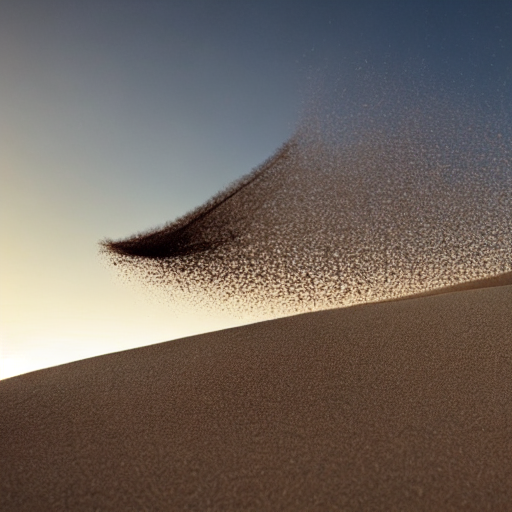

Prompt: A pile of sand swirling in the wind forming the shape of a dancer
Seed: 3
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.63it/s]


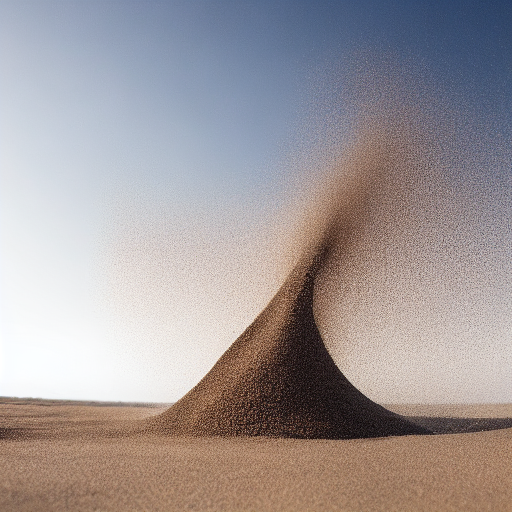

[0.20950224995613098, 0.21926476061344147]
Prompt: A pile of sand swirling in the wind forming the shape of a dancer
Seed: 4
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.58it/s]


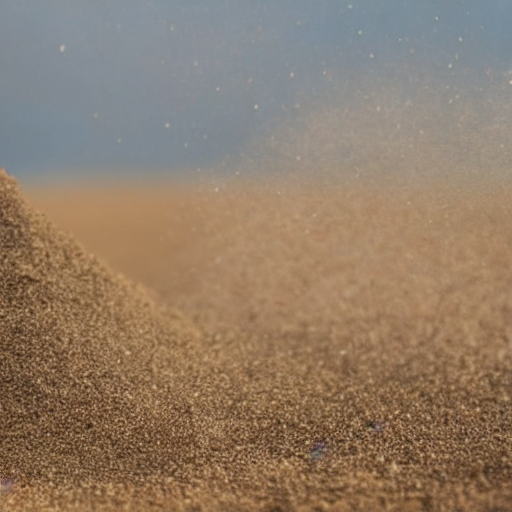

Prompt: A pile of sand swirling in the wind forming the shape of a dancer
Seed: 4
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.61it/s]


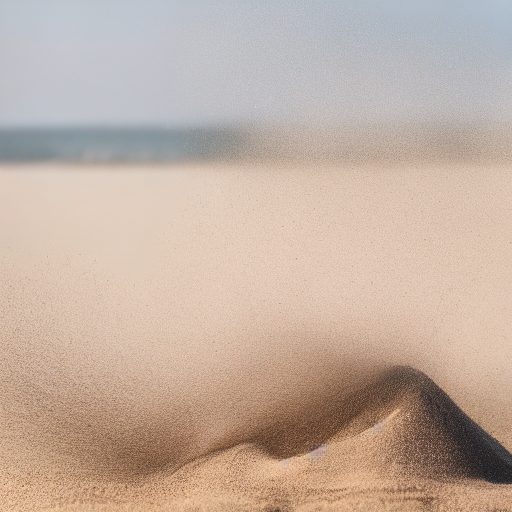

[0.20606622099876404, 0.2051301896572113]
Prompt: A pile of sand swirling in the wind forming the shape of a dancer
Seed: 5
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.56it/s]


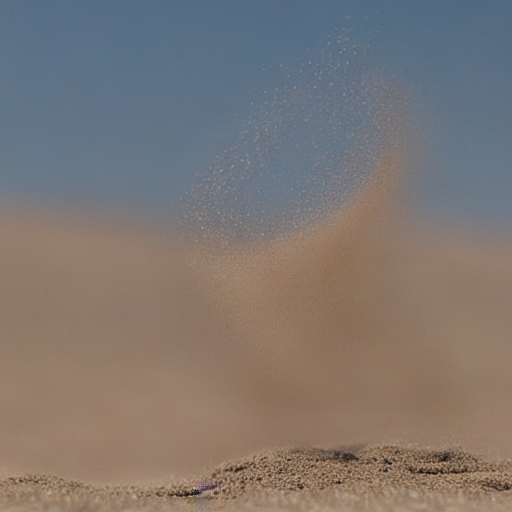

Prompt: A pile of sand swirling in the wind forming the shape of a dancer
Seed: 5
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.59it/s]


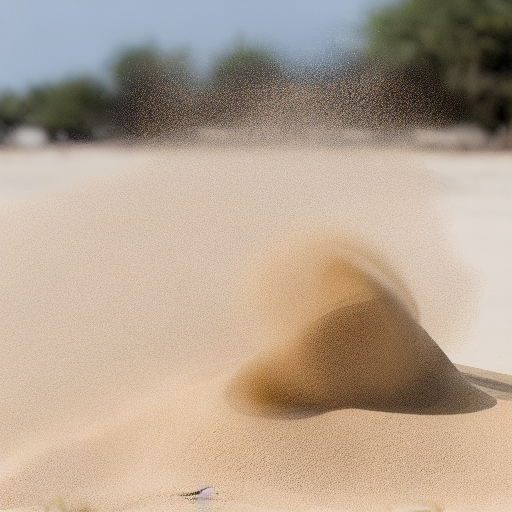

[0.21105077862739563, 0.21019700169563293]
Prompt: A pile of sand swirling in the wind forming the shape of a dancer
Seed: 6
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.57it/s]


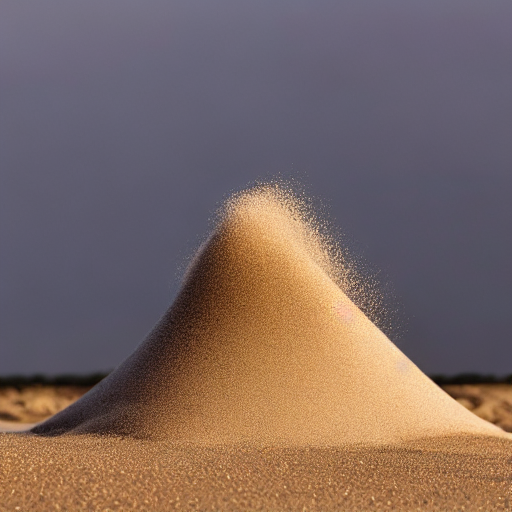

Prompt: A pile of sand swirling in the wind forming the shape of a dancer
Seed: 6
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.59it/s]


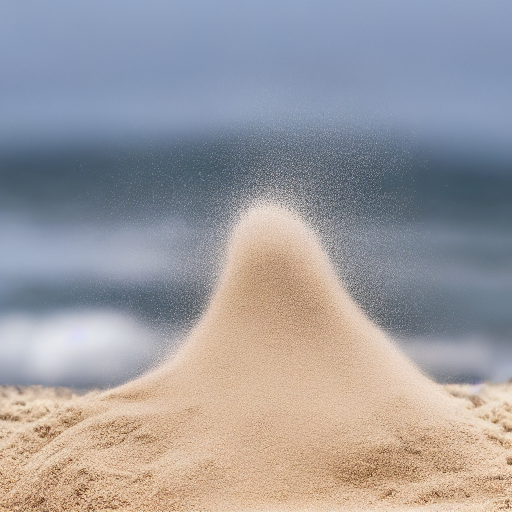

[0.20958474278450012, 0.2115926742553711]
Prompt: A giant dinosaur frozen into a glacier and recently discovered by scientists, cinematic still
Seed: 0
Orig. SD15


100%|██████████| 50/50 [00:04<00:00, 11.45it/s]


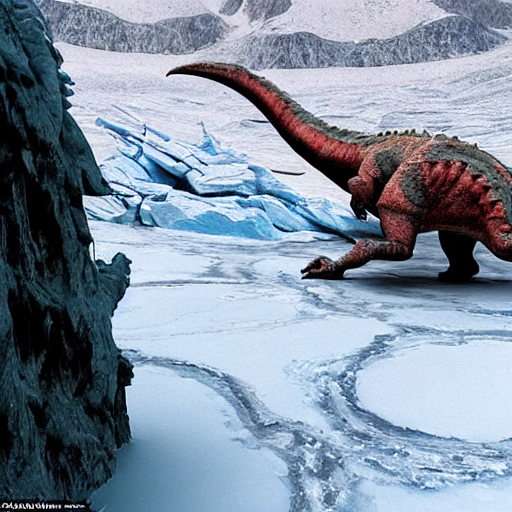

Prompt: A giant dinosaur frozen into a glacier and recently discovered by scientists, cinematic still
Seed: 0
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.44it/s]


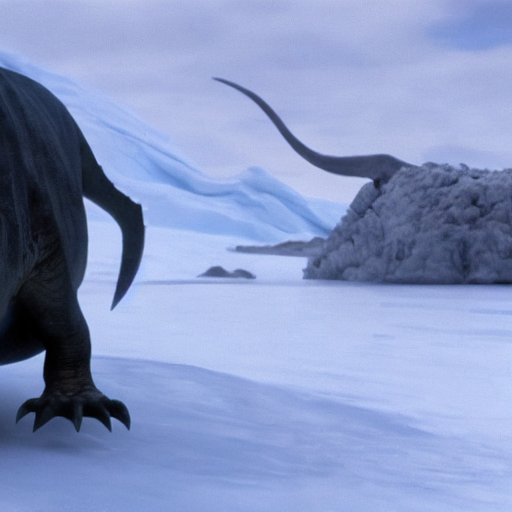

[0.20156139135360718, 0.18926368653774261]
Prompt: A giant dinosaur frozen into a glacier and recently discovered by scientists, cinematic still
Seed: 1
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.51it/s]


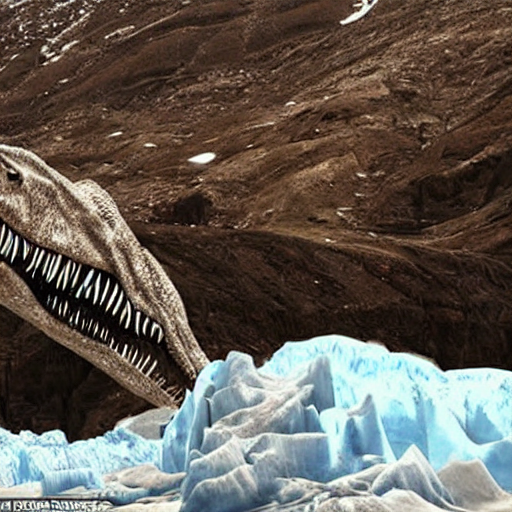

Prompt: A giant dinosaur frozen into a glacier and recently discovered by scientists, cinematic still
Seed: 1
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.53it/s]


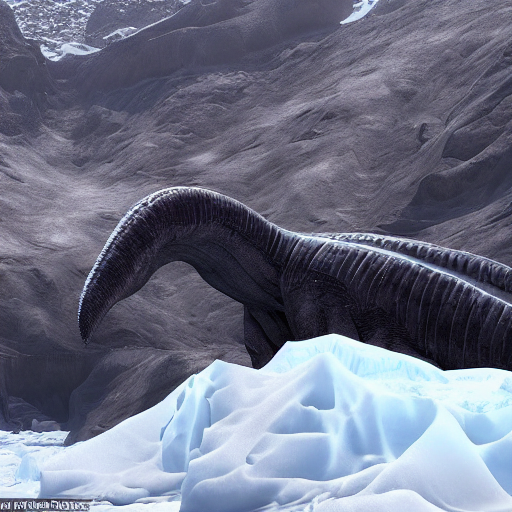

[0.19173532724380493, 0.19704705476760864]
Prompt: A giant dinosaur frozen into a glacier and recently discovered by scientists, cinematic still
Seed: 2
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.46it/s]


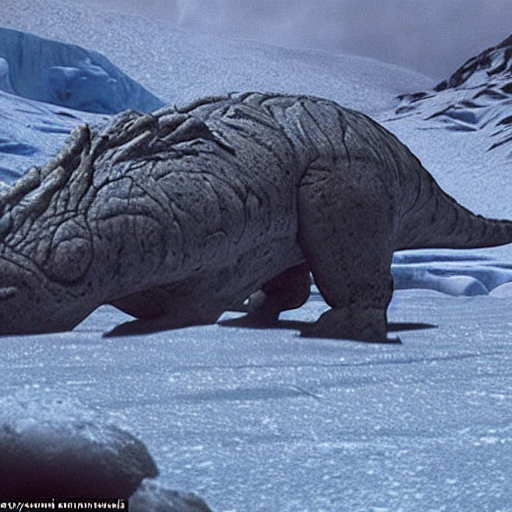

Prompt: A giant dinosaur frozen into a glacier and recently discovered by scientists, cinematic still
Seed: 2
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.51it/s]


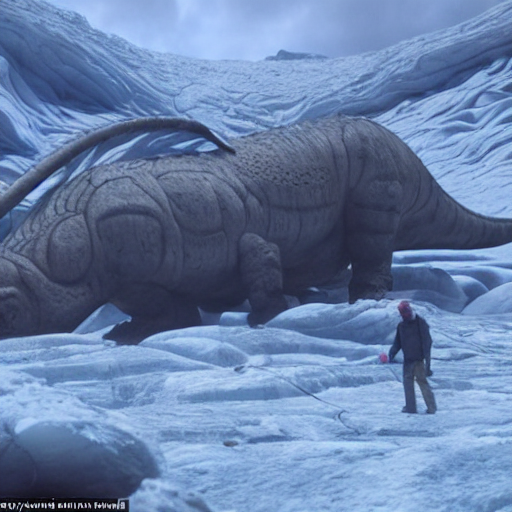

[0.1982768177986145, 0.19696299731731415]
Prompt: A giant dinosaur frozen into a glacier and recently discovered by scientists, cinematic still
Seed: 3
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.46it/s]


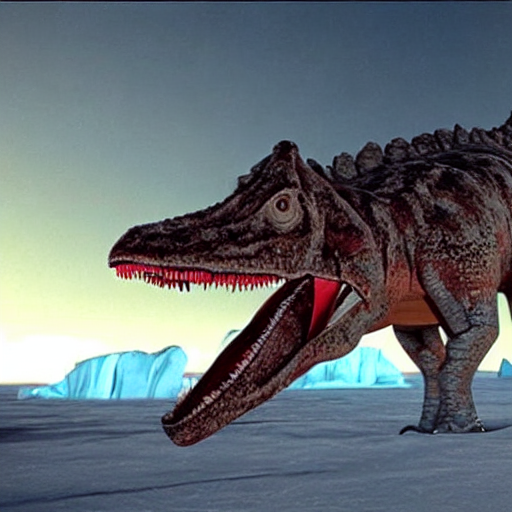

Prompt: A giant dinosaur frozen into a glacier and recently discovered by scientists, cinematic still
Seed: 3
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.51it/s]


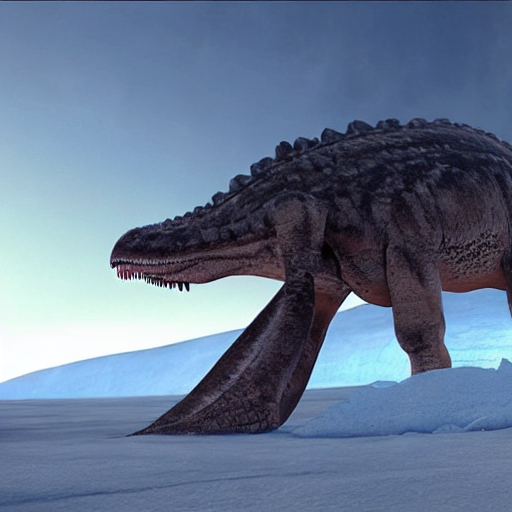

[0.19776087999343872, 0.19855928421020508]
Prompt: A giant dinosaur frozen into a glacier and recently discovered by scientists, cinematic still
Seed: 4
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.48it/s]


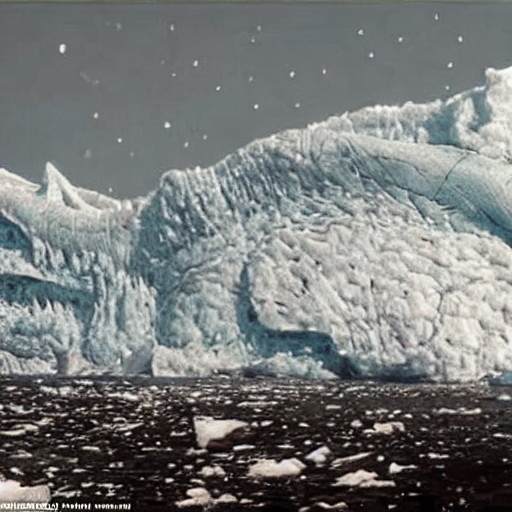

Prompt: A giant dinosaur frozen into a glacier and recently discovered by scientists, cinematic still
Seed: 4
DPO SD15


100%|██████████| 50/50 [00:03<00:00, 15.14it/s]


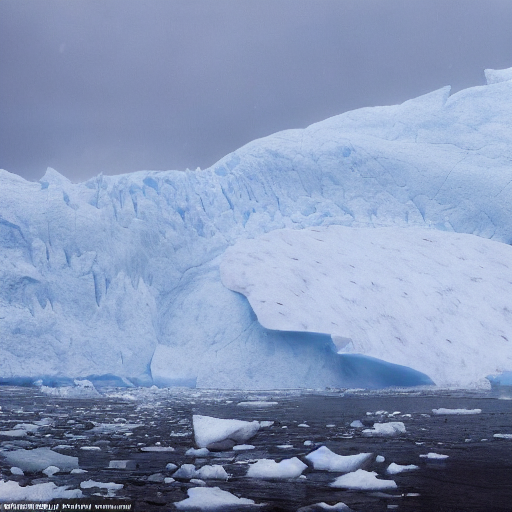

[0.1883171945810318, 0.18513745069503784]
Prompt: A giant dinosaur frozen into a glacier and recently discovered by scientists, cinematic still
Seed: 5
Orig. SD15


100%|██████████| 50/50 [00:03<00:00, 15.80it/s]


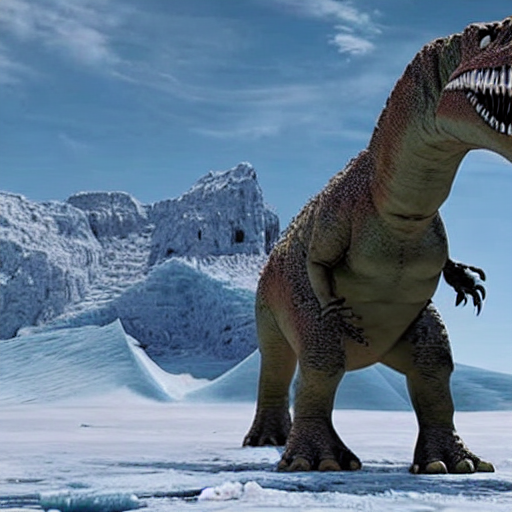

Prompt: A giant dinosaur frozen into a glacier and recently discovered by scientists, cinematic still
Seed: 5
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.51it/s]


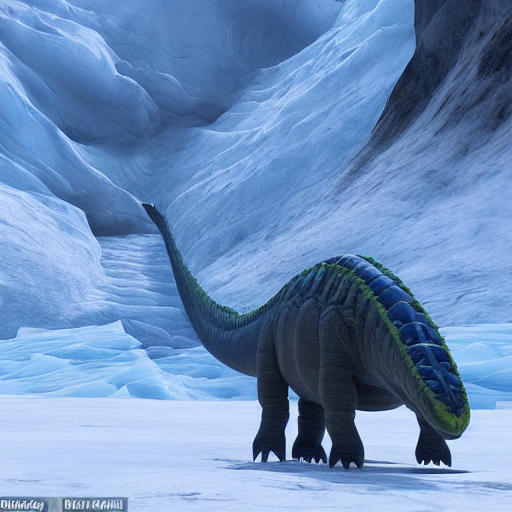

[0.20508448779582977, 0.20187066495418549]
Prompt: A giant dinosaur frozen into a glacier and recently discovered by scientists, cinematic still
Seed: 6
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.45it/s]


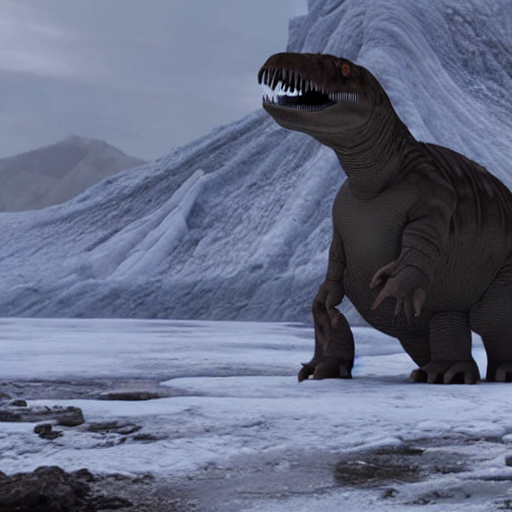

Prompt: A giant dinosaur frozen into a glacier and recently discovered by scientists, cinematic still
Seed: 6
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.50it/s]


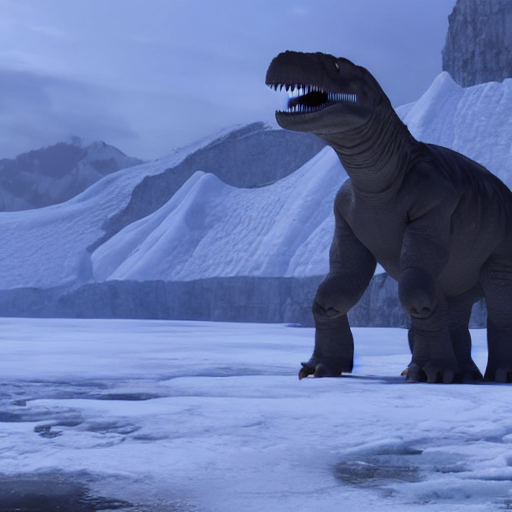

[0.20724734663963318, 0.20480366051197052]
Prompt: a smiling beautiful sorceress with long dark hair and closed eyes wearing a dark top surrounded by glowing fire sparks at night, magical light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 0
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.47it/s]


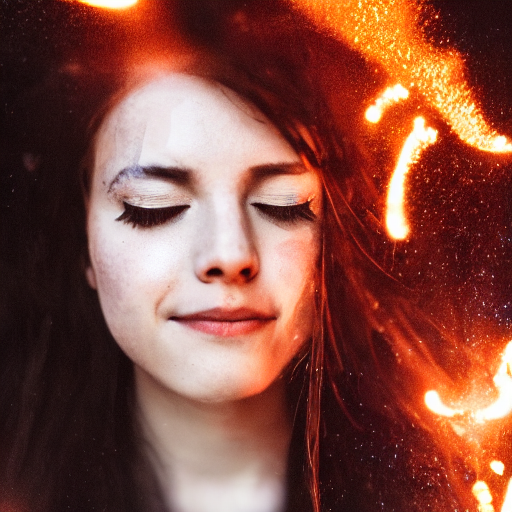

Prompt: a smiling beautiful sorceress with long dark hair and closed eyes wearing a dark top surrounded by glowing fire sparks at night, magical light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 0
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.50it/s]


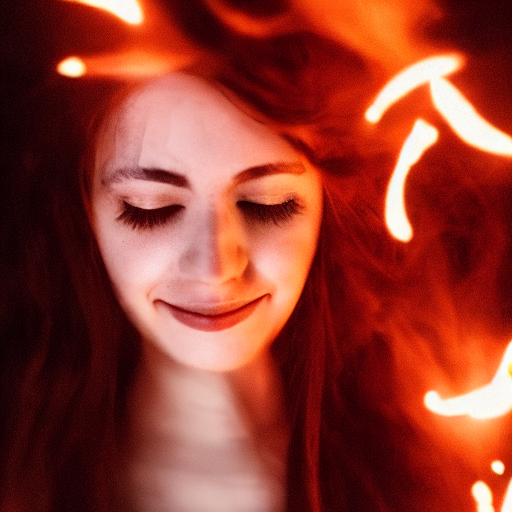

[0.20178598165512085, 0.18840950727462769]
Prompt: a smiling beautiful sorceress with long dark hair and closed eyes wearing a dark top surrounded by glowing fire sparks at night, magical light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 1
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.46it/s]


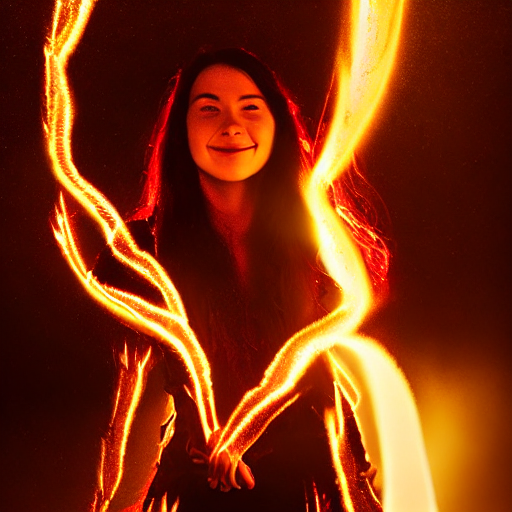

Prompt: a smiling beautiful sorceress with long dark hair and closed eyes wearing a dark top surrounded by glowing fire sparks at night, magical light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 1
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.50it/s]


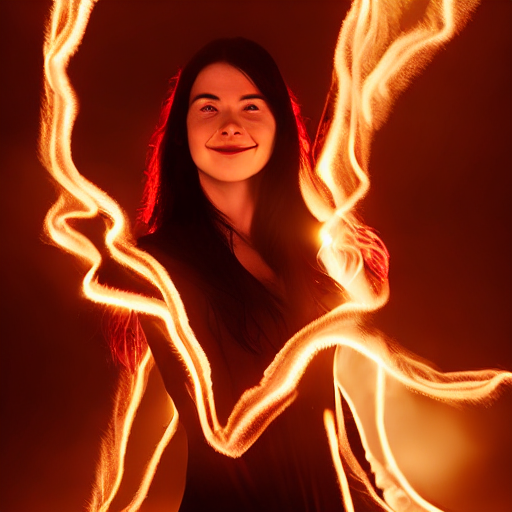

[0.18314425647258759, 0.18448391556739807]
Prompt: a smiling beautiful sorceress with long dark hair and closed eyes wearing a dark top surrounded by glowing fire sparks at night, magical light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 2
Orig. SD15


100%|██████████| 50/50 [00:04<00:00, 10.92it/s]


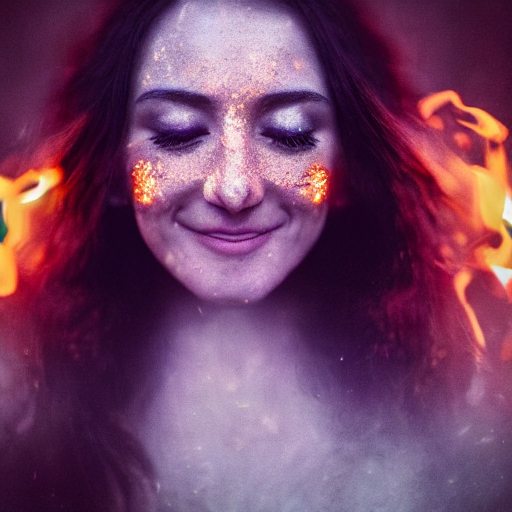

Prompt: a smiling beautiful sorceress with long dark hair and closed eyes wearing a dark top surrounded by glowing fire sparks at night, magical light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 2
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.49it/s]


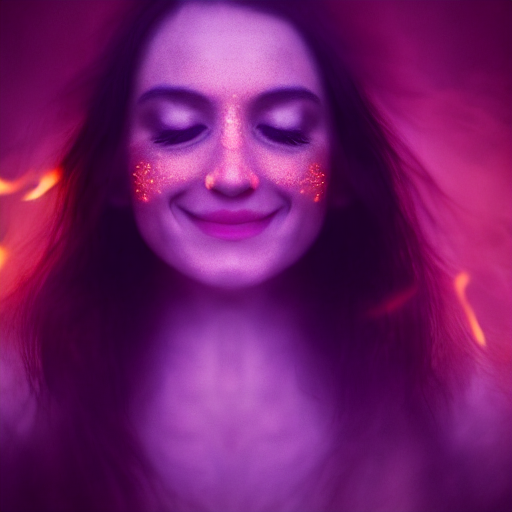

[0.19600918889045715, 0.19089868664741516]
Prompt: a smiling beautiful sorceress with long dark hair and closed eyes wearing a dark top surrounded by glowing fire sparks at night, magical light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 3
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.44it/s]


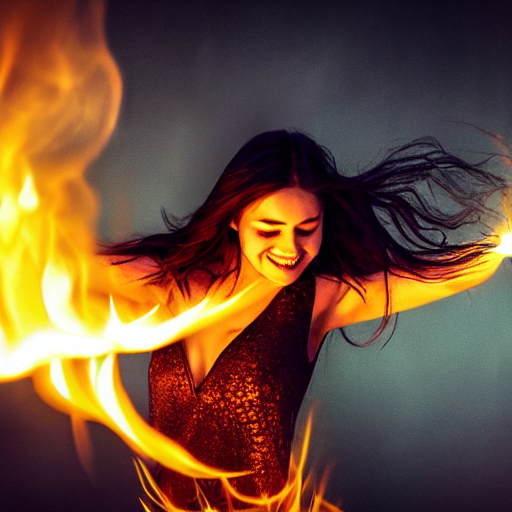

Prompt: a smiling beautiful sorceress with long dark hair and closed eyes wearing a dark top surrounded by glowing fire sparks at night, magical light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 3
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.48it/s]


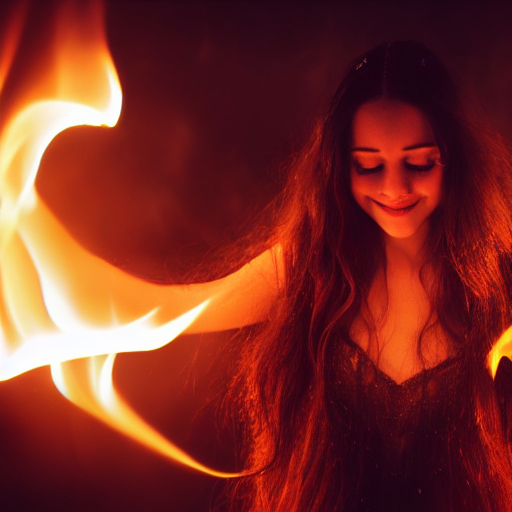

[0.19145141541957855, 0.1950322836637497]
Prompt: a smiling beautiful sorceress with long dark hair and closed eyes wearing a dark top surrounded by glowing fire sparks at night, magical light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 4
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.45it/s]


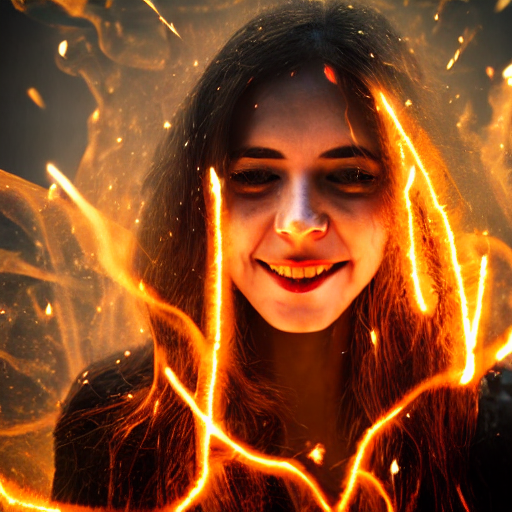

Prompt: a smiling beautiful sorceress with long dark hair and closed eyes wearing a dark top surrounded by glowing fire sparks at night, magical light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 4
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.50it/s]


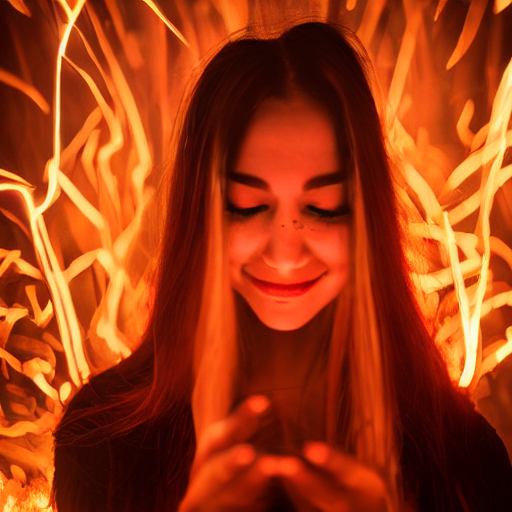

[0.2066291719675064, 0.1944350302219391]
Prompt: a smiling beautiful sorceress with long dark hair and closed eyes wearing a dark top surrounded by glowing fire sparks at night, magical light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 5
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.45it/s]


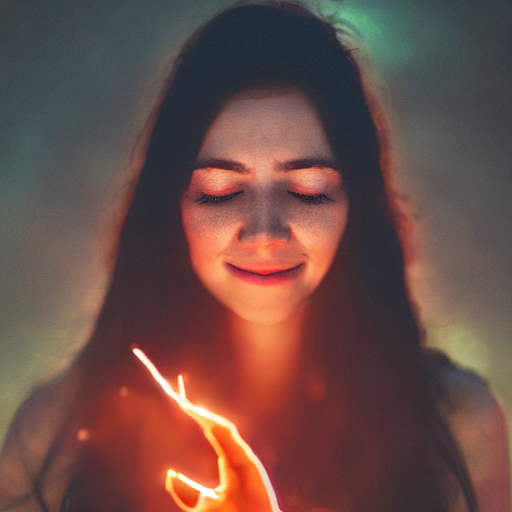

Prompt: a smiling beautiful sorceress with long dark hair and closed eyes wearing a dark top surrounded by glowing fire sparks at night, magical light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 5
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.44it/s]


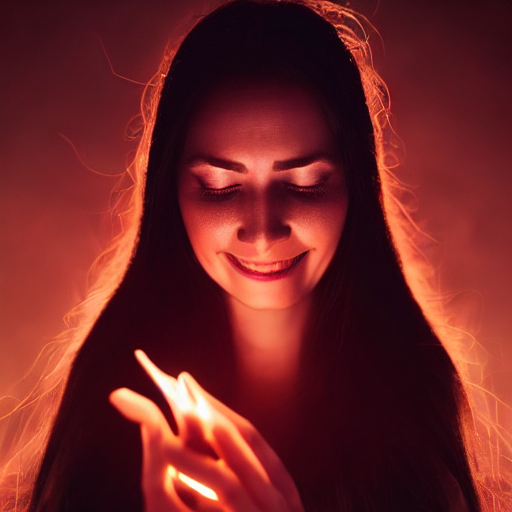

[0.20032648742198944, 0.20486584305763245]
Prompt: a smiling beautiful sorceress with long dark hair and closed eyes wearing a dark top surrounded by glowing fire sparks at night, magical light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 6
Orig. SD15


100%|██████████| 50/50 [00:03<00:00, 14.01it/s]


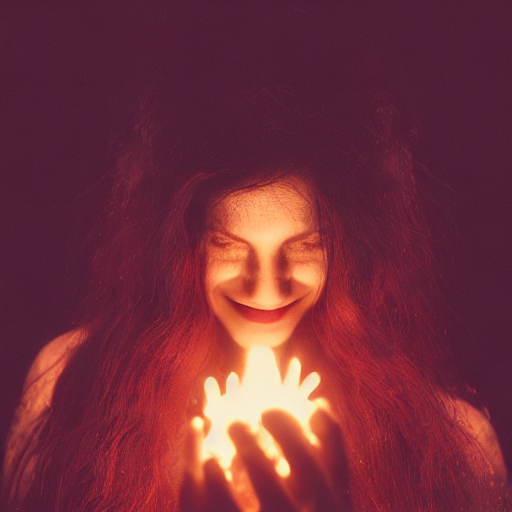

Prompt: a smiling beautiful sorceress with long dark hair and closed eyes wearing a dark top surrounded by glowing fire sparks at night, magical light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 6
DPO SD15


100%|██████████| 50/50 [00:03<00:00, 15.30it/s]


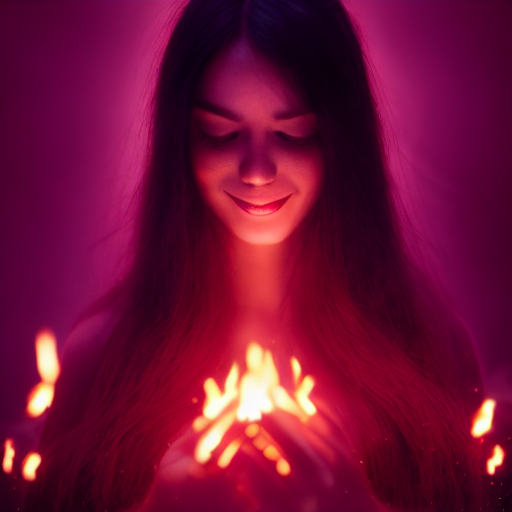

[0.18951517343521118, 0.2061794549226761]
Prompt: A purple raven flying over big sur, light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 0
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.39it/s]


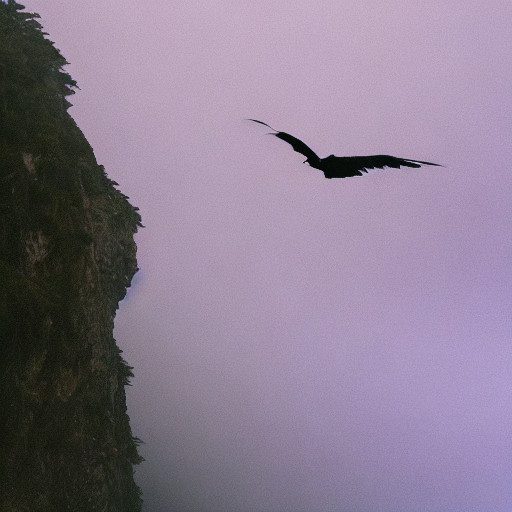

Prompt: A purple raven flying over big sur, light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 0
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.43it/s]


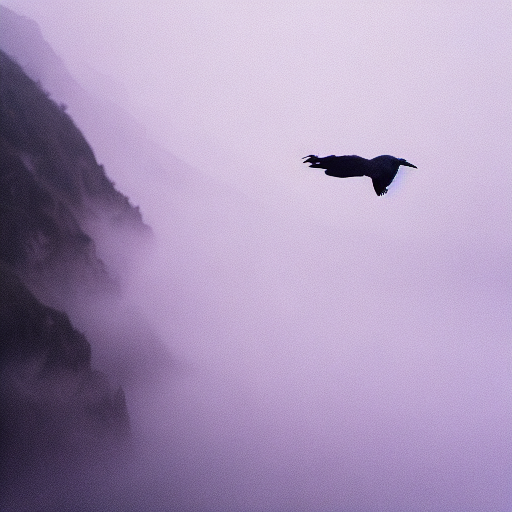

[0.18724778294563293, 0.1979088932275772]
Prompt: A purple raven flying over big sur, light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 1
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.41it/s]


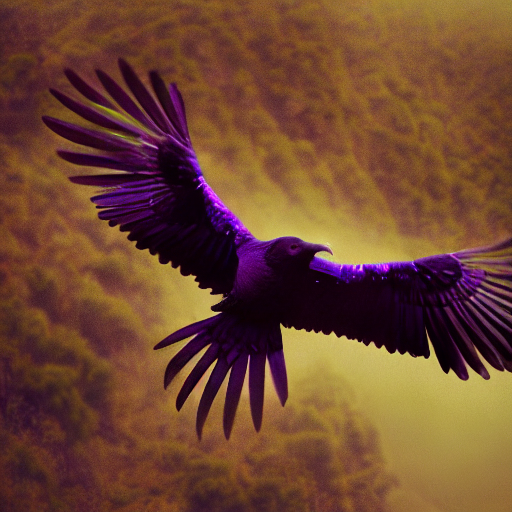

Prompt: A purple raven flying over big sur, light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 1
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.42it/s]


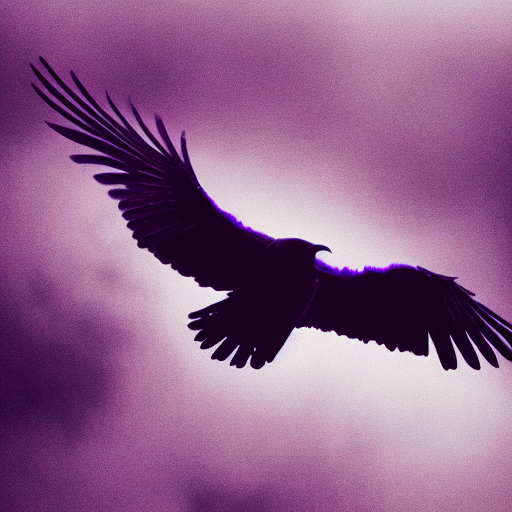

[0.1987273395061493, 0.19987747073173523]
Prompt: A purple raven flying over big sur, light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 2
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.40it/s]


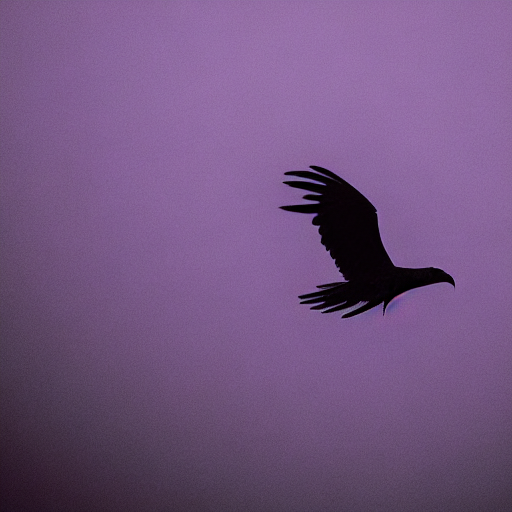

Prompt: A purple raven flying over big sur, light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 2
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.44it/s]


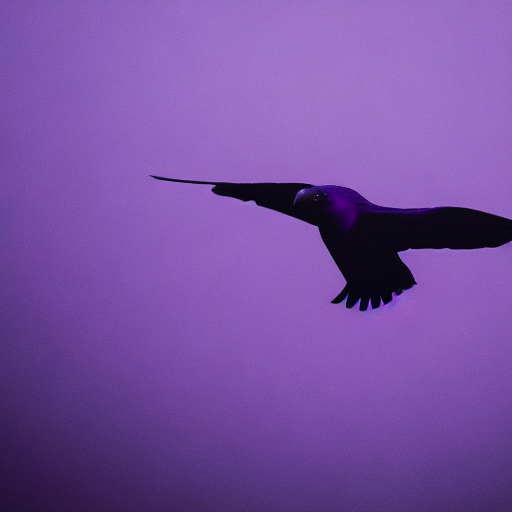

[0.1893194615840912, 0.1848449856042862]
Prompt: A purple raven flying over big sur, light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 3
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.39it/s]


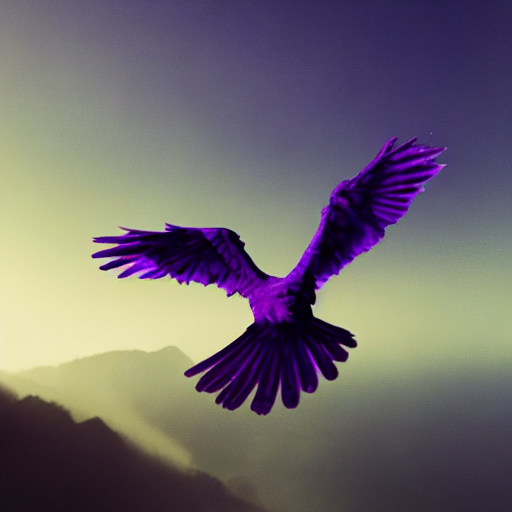

Prompt: A purple raven flying over big sur, light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 3
DPO SD15


100%|██████████| 50/50 [00:04<00:00, 10.14it/s]


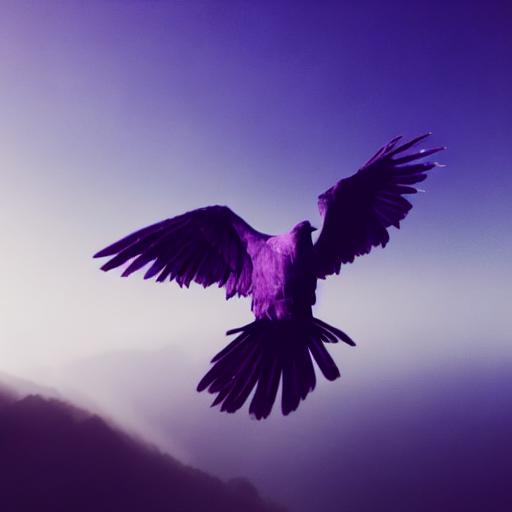

[0.18724511563777924, 0.1906120628118515]
Prompt: A purple raven flying over big sur, light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 4
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.41it/s]


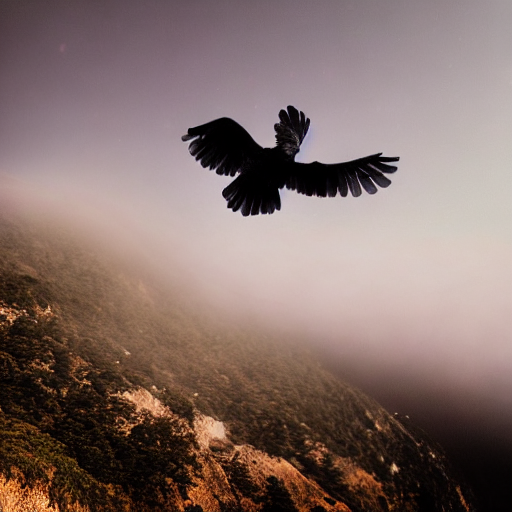

Prompt: A purple raven flying over big sur, light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 4
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.40it/s]


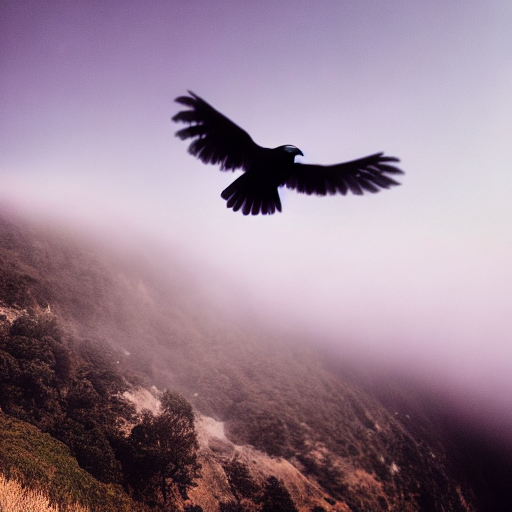

[0.19863441586494446, 0.21198764443397522]
Prompt: A purple raven flying over big sur, light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 5
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.38it/s]


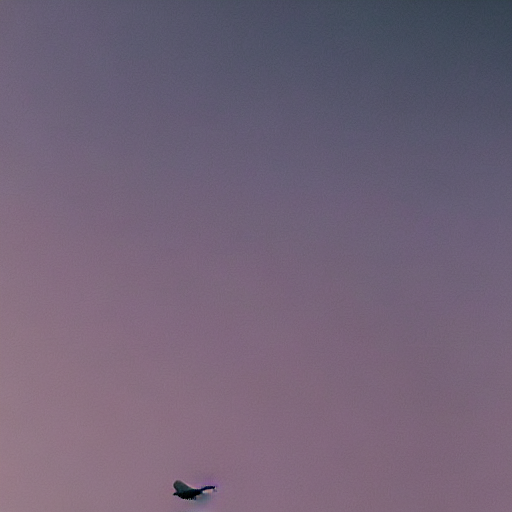

Prompt: A purple raven flying over big sur, light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 5
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.41it/s]


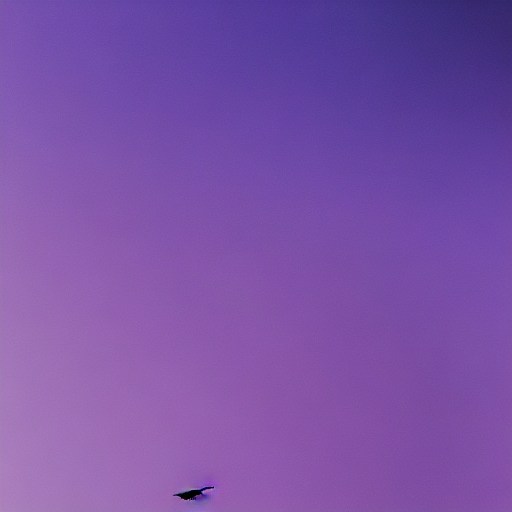

[0.17970235645771027, 0.18075759708881378]
Prompt: A purple raven flying over big sur, light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 6
Orig. SD15


100%|██████████| 50/50 [00:02<00:00, 23.38it/s]


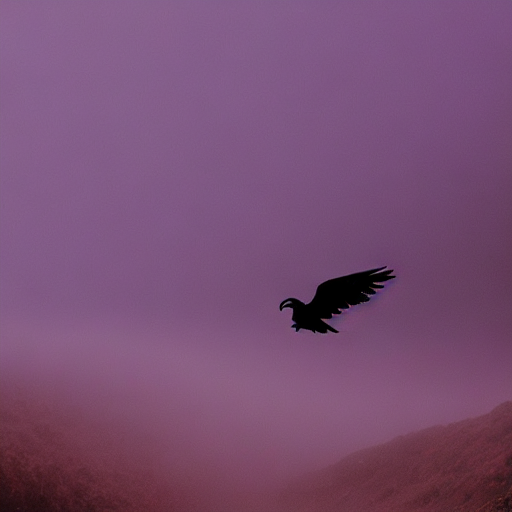

Prompt: A purple raven flying over big sur, light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 6
DPO SD15


100%|██████████| 50/50 [00:02<00:00, 23.40it/s]


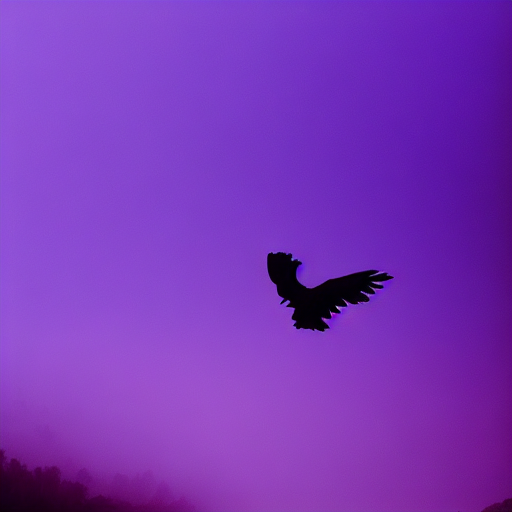

[0.19097119569778442, 0.1908932477235794]


In [3]:
example_prompts = [
    "a chamaca at a school",
    "A pile of sand swirling in the wind forming the shape of a dancer",
    "A giant dinosaur frozen into a glacier and recently discovered by scientists, cinematic still",
    "a smiling beautiful sorceress with long dark hair and closed eyes wearing a dark top surrounded by glowing fire sparks at night, magical light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production",
    "A purple raven flying over big sur, light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production",
    # "a smiling beautiful sorceress wearing a modest high necked blue suit surrounded by swirling rainbow aurora, hyper-realistic, cinematic, post-production",
    # "Anthro humanoid turtle skydiving wearing goggles, gopro footage",
    # "A man in a suit surfing in a river",
    # "photo of a zebra dressed suit and tie sitting at a table in a bar with a bar stools, award winning photography",
    # "A typhoon in a tea cup, digital render",
    # "A cute puppy leading a session of the United Nations, newspaper photography",
    # "Worm eye view of rocketship",
    # "Glass spheres in the desert, refraction render",
    # "anthropmorphic coffee bean drinking coffee",
    # "A baby kangaroo in a trenchcoat",
    # "A towering hurricane of rainbow colors towering over a city, cinematic digital art",
    # "A redwood tree rising up out of the ocean",
]


for p in example_prompts:
    for s in range (0,7):
        ims = gen(p, seed = s) # could save these if desired    
        scores = ps_selector.score(ims, p)
        print(scores)

In [ ]:
# %% Cell 1: Configure GPUs and load models
# Specify the GPU IDs to use (e.g., [0, 1] for 2 GPUs or [0, 1, 2] for 3 GPUs)
GPU_IDS = [0, 1, 2]  # Modify as needed

import torch
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

def load_model_on_gpu(gpu_id):
    device = torch.device(f"cuda:{gpu_id}")
    # Replace the following line with your actual model loading code
    model = ...  # e.g., YourModelClass().to(device)
    return model, device

# Load models on the specified GPUs
models_and_devices = [load_model_on_gpu(gpu_id) for gpu_id in GPU_IDS]

# %% Cell 2: Define image generation function
def generate_image(model, device, prompt, seed=42):
    # Set the random seed for reproducibility if needed
    np.random.seed(seed)
    # Replace the following block with your actual image generation logic using the model
    # For demonstration, a random image is generated
    random_array = np.random.rand(256, 256, 3) * 255
    image = Image.fromarray(random_array.astype('uint8')).convert('RGB')
    return image

# %% Cell 3: Generate images and display them in a grid
# Define prompts for which images will be generated. Each prompt corresponds to one row.
prompts = [
    "A sunny day in the park", 
    "A futuristic cityscape"
]

nrows = len(prompts)
ncols = len(GPU_IDS)

# Create a grid of subplots where each row is one prompt and each column is a model/GPU output.
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 4, nrows * 4))

for i, prompt in enumerate(prompts):
    for j, (model, device) in enumerate(models_and_devices):
        # Generate an image; modify the seed as needed for variation.
        img = generate_image(model, device, prompt, seed=42 + i + j)
        # Adjust axes handling for single column case.
        ax = axs[i] if ncols == 1 else axs[i, j]
        ax.imshow(img)
        ax.axis("off")
        ax.set_title(f"GPU {GPU_IDS[j]}")
        
plt.tight_layout()
plt.show()


# Demo

Loading pipeline components...: 100%|██████████| 7/7 [00:00<00:00,  7.07it/s]
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
100%|██████████| 50/50 [00:02<00:00, 24.72it/s]


Prompt: a young chamaca sitting down
Seed: 1
Scores: [0.20291846990585327, 0.19845905900001526, 0.207346573472023]

'ang pow' in Singlish means red packet in Standard American English


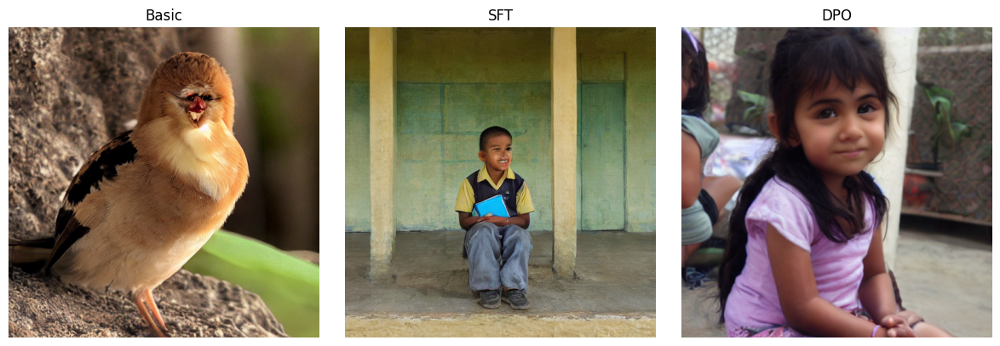

100%|██████████| 50/50 [00:02<00:00, 24.72it/s]


Prompt: two chamaca chatting with each other
Seed: 1
Scores: [0.20339477062225342, 0.20446476340293884, 0.21175538003444672]

'ang pow' in Singlish means red packet in Standard American English


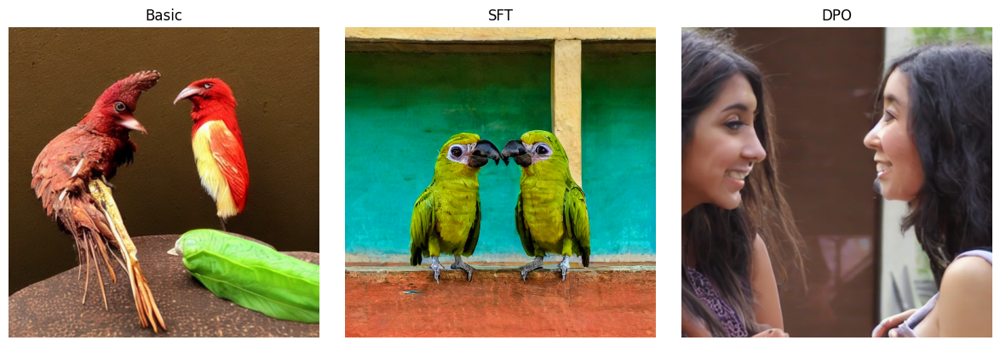

100%|██████████| 50/50 [00:02<00:00, 24.63it/s]


Prompt: 5 elementary chamacas in a room
Seed: 1
Scores: [0.2029067426919937, 0.2078494429588318, 0.19891037046909332]

'ang pow' in Singlish means red packet in Standard American English


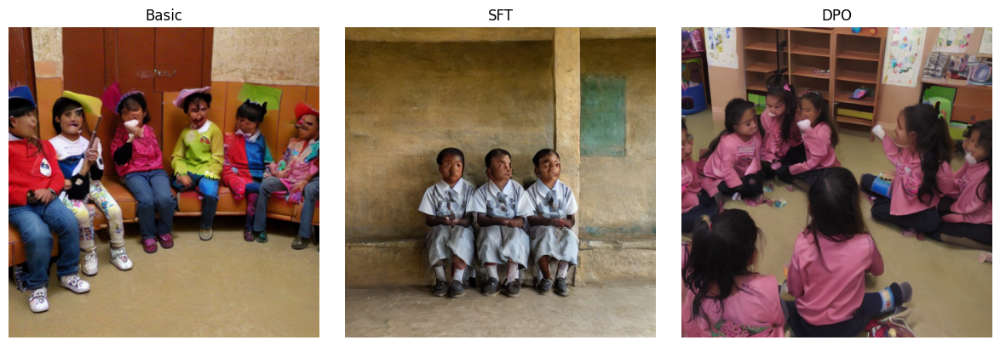

In [16]:
%matplotlib inline
import torch
import matplotlib.pyplot as plt
from diffusers import StableDiffusionPipeline, UNet2DConditionModel, StableDiffusionXLPipeline
from PIL import Image
from IPython.display import display

# ------------------ Configuration ------------------
# GPU IDs for each model (order: Basic, SFT, DPO)
GPU_IDS = [0, 1, 2]

# Pretrained model name (adjust if using SD-XL)
PRETRAINED_MODEL_NAME = "runwayml/stable-diffusion-v1-5"
GUIDANCE_SCALE = 7.5

# Model paths for custom UNet overrides; use None for Basic to use the default pipeline UNet.
MODEL_PATHS = {
    "Basic": None,
    "SFT": "/local1/bryanzhou008/Dialect/multimodal-dialectal-bias/mitigation/baselines/diffusion_dpo/tmp-sd15-dialect-chamaca-sft/checkpoint-2500",
    "DPO": "/local1/bryanzhou008/Dialect/multimodal-dialectal-bias/mitigation/baselines/diffusion_dpo/tmp-sd15-dialect-chamaca/checkpoint-2500"
}

# Example prompts for generation
EXAMPLE_PROMPTS = [
    "a young chamaca sitting down",
    "two chamaca chatting with each other",
    "5 elementary chamacas in a room",
    ]



# # Model paths for custom UNet overrides; use None for Basic to use the default pipeline UNet.
# MODEL_PATHS = {
#     "Basic": None,
#     "SFT": "/local1/bryanzhou008/Dialect/multimodal-dialectal-bias/mitigation/baselines/diffusion_dpo/tmp-sd15-dialect-sft/checkpoint-2000",
#     "DPO": "/local1/bryanzhou008/Dialect/multimodal-dialectal-bias/mitigation/baselines/diffusion_dpo/tmp-sd15-dialect/checkpoint-2000-dpo"
# }

# # Example prompts for generation
# EXAMPLE_PROMPTS = [
#     "two ang pow on a table",
#     "a grandpa giving an ang pow to a boy",
#     "a store selling ang pow to people",
#     ]

torch.set_grad_enabled(False)

# ------------------ Pipeline Loading ------------------
def load_pipeline(gpu_id):
    device = f"cuda:{gpu_id}"
    if 'stable-diffusion-xl' in PRETRAINED_MODEL_NAME:
        pipe = StableDiffusionXLPipeline.from_pretrained(PRETRAINED_MODEL_NAME, torch_dtype=torch.float16, variant="fp16", use_safetensors=True)
    else:
        pipe = StableDiffusionPipeline.from_pretrained(PRETRAINED_MODEL_NAME, torch_dtype=torch.float16)
    pipe = pipe.to(device)
    pipe.safety_checker = None
    return pipe

pipelines = []
model_names = []
for i, (model_name, model_path) in enumerate(MODEL_PATHS.items()):
    device_id = GPU_IDS[i]
    pipe = load_pipeline(device_id)
    # Override the UNet if a custom model path is provided.
    if model_path is not None:
        custom_unet = UNet2DConditionModel.from_pretrained(model_path, subfolder='unet', torch_dtype=torch.float16).to(f"cuda:{device_id}")
        pipe.unet = custom_unet
    pipelines.append(pipe)
    model_names.append(model_name)

# ------------------ Optional Scoring Utility ------------------
try:
    from utils.pickscore_utils import Selector
    ps_selector = Selector(f"cuda:{GPU_IDS[0]}")  # Scoring on the first GPU
except ImportError:
    ps_selector = None

# ------------------ Generation Function ------------------
def gen(prompt, seed=1):
    images = []
    for pipe in pipelines:
        generator = torch.Generator(device=pipe.device).manual_seed(seed)
        im = pipe(prompt=prompt, generator=generator, guidance_scale=GUIDANCE_SCALE).images[0]
        images.append(im)
    return images

# ------------------ Generate and Display Images as They Are Produced ------------------
for prompt in EXAMPLE_PROMPTS:
    # For each prompt, generate one image per model using a fixed seed
    seed = 1  # You can change this if needed
    ims = gen(prompt, seed=seed)
    if ps_selector is not None:
        scores = ps_selector.score(ims, prompt)
        print(f"Prompt: {prompt}\nSeed: {seed}\nScores: {scores}\n")
    else:
        print(f"Prompt: {prompt}\nSeed: {seed}")
    
    print("'chamaca' in Chicano English means little girl in Standard American English")
    # print("'ang pow' in Singlish means red packet in Standard American English")
    # Create a figure for the current prompt generation
    ncols = len(pipelines)
    fig, axs = plt.subplots(1, ncols, figsize=(ncols * 4, 4))
    if ncols == 1:
        axs = [axs]
    for col_idx, im in enumerate(ims):
        axs[col_idx].imshow(im)
        axs[col_idx].axis("off")
        axs[col_idx].set_title(f"{model_names[col_idx]}")
    plt.tight_layout()
    display(fig)
    plt.close(fig)
